In [23]:
from qocag import control_ani
import numpy as np
result=np.load("./out/00004_fock2.npy",allow_pickle=True).item()
import matplotlib.pyplot as plt
import matplotlib
from numpy.fft import rfft, rfftfreq

In [24]:
controls=result["control_iter"]
times=result["times"]
cost_iter=result["cost_iter"]

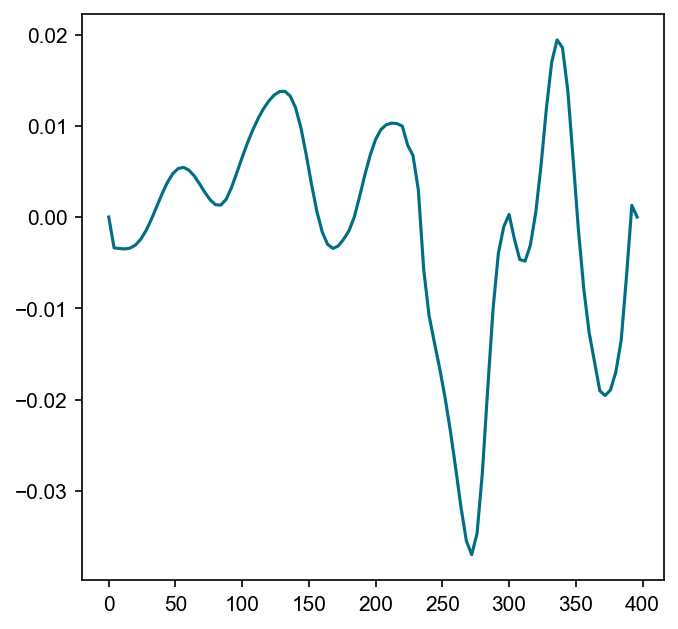

In [25]:
import matplotlib.pyplot as plt
cost_len=len(cost_iter)
fig, (ax) = plt.subplots(figsize=(5,5))
ax.plot(times, controls[-1][0])

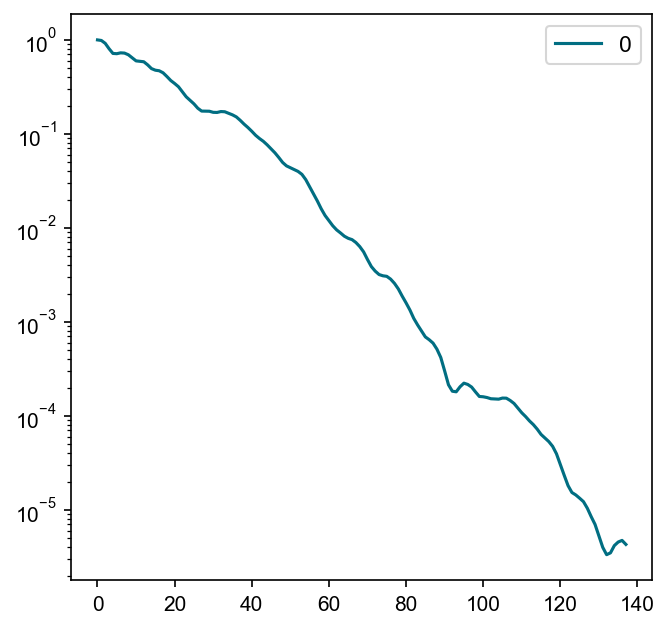

In [26]:
import matplotlib.pyplot as plt
cost_len=len(cost_iter)
fig, (ax) = plt.subplots(figsize=(5,5))
for i in range(cost_len):
    ax.plot(cost_iter[i],label=str(i))
ax.legend()
ax.set_yscale('log')

<Figure size 800x800 with 0 Axes>

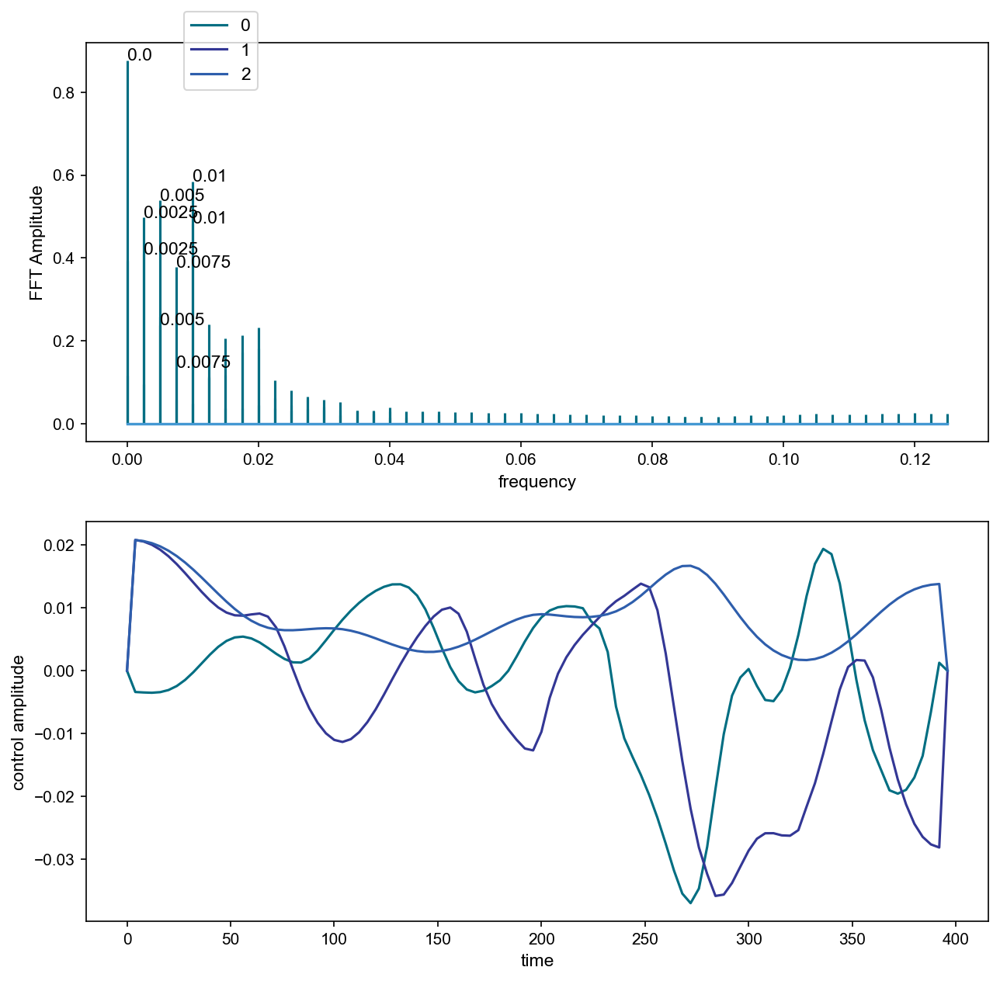

In [27]:
ani=control_ani(result,)
from IPython.display import HTML
HTML(ani.to_jshtml())

In [1]:
import autograd.numpy as anp

In [3]:
A=anp.random.rand(5,5)
A=A+anp.transpose(A)
B=anp.random.rand(5,5)
B=B+anp.transpose(B)
psi=anp.random.rand(5)+1j*anp.random.rand(5)
psi=psi.reshape(len(psi),1)
phi=anp.array([anp.random.rand(5)+1j*anp.random.rand(5)])
S=anp.matmul(psi,phi)


In [25]:

def cost(x):
    H=-0.01j*(A+x*B)
    D,U=anp.linalg.eig(H)
    D=anp.diag(anp.exp(D))
    exp=U@D@anp.transpose(anp.conjugate(U))
    return exp
def get_D(x):
    H=-0.01j*(A+x*B)
    D,U=anp.linalg.eig(H)
    return D,U
dU=(get_D(1.001)[1]-get_D(1)[1])/0.001


In [26]:
(cost(1.0001)-cost(1))/0.0001

array([[-0.00105297-0.01399428j, -0.00098871-0.00721798j,
        -0.00105133-0.00591521j, -0.0010731 -0.01099676j,
        -0.00102604-0.00714159j],
       [-0.00098871-0.00721798j, -0.00128907-0.01599095j,
        -0.0010121 -0.00264518j, -0.00109789-0.00886226j,
        -0.00113695-0.01676949j],
       [-0.00105133-0.00591521j, -0.0010121 -0.00264518j,
        -0.00118142-0.01706446j, -0.00114502-0.01461397j,
        -0.00103635-0.01154619j],
       [-0.0010731 -0.01099676j, -0.00109789-0.00886226j,
        -0.00114502-0.01461397j, -0.00124014-0.00663324j,
        -0.00111544-0.01043853j],
       [-0.00102604-0.00714159j, -0.00113695-0.01676949j,
        -0.00103635-0.01154619j, -0.00111544-0.01043853j,
        -0.00120934-0.00453577j]])

In [49]:
def get_F(D):
    d=len(D)
    F=np.zeros((d,d),dtype=np.complex)
    for i in range(d):
        for j in range(d):
            if i!=j:
                F[i][j]=1/(D[j]-D[i])
    return F
def get_J(D):
    d=len(D)
    J=np.zeros((d,d),dtype=np.complex)
    for i in range(d):
        for j in range(d):
            if i!=j:
                J[i][j]=(np.exp(D[j])-np.exp(D[i]))
    return J

In [45]:
H=-0.01j*(A+1*B)
D,U=anp.linalg.eig(H)
U_dag=np.transpose(np.conjugate(U))
expD=anp.diag(anp.exp(D))
sp=U_dag@S@U

In [46]:
F=get_F(D)
J=get_J(D)
first=(expD@sp)*np.transpose(F)
sec=(sp@expD)*(np.identity(5)+F)
np.trace(U@(first+sec)@U_dag@(-0.01j*B))

(0.17346477318996212-0.03186423418887144j)

In [50]:
import numpy as np
F=get_F(D)
J=get_J(D)
H=-0.01j*(A+1*B)
D,U=anp.linalg.eig(H)
U_dag=np.transpose(np.conjugate(U))
dH=-0.01j*B
F=get_F(D)
J=get_J(D)
U@((expD+J*F)*(U_dag@dH@U))@U_dag

array([[-0.00105295-0.01399428j, -0.00098868-0.00721798j,
        -0.00105131-0.00591521j, -0.00107307-0.01099676j,
        -0.00102602-0.0071416j ],
       [-0.00098868-0.00721798j, -0.00128903-0.01599095j,
        -0.00101208-0.00264518j, -0.00109787-0.00886226j,
        -0.00113692-0.01676949j],
       [-0.00105131-0.00591521j, -0.00101208-0.00264518j,
        -0.00118138-0.01706446j, -0.00114499-0.01461397j,
        -0.00103633-0.01154619j],
       [-0.00107307-0.01099676j, -0.00109787-0.00886226j,
        -0.00114499-0.01461397j, -0.00124011-0.00663325j,
        -0.00111541-0.01043853j],
       [-0.00102602-0.0071416j , -0.00113692-0.01676949j,
        -0.00103633-0.01154619j, -0.00111541-0.01043853j,
        -0.00120931-0.00453577j]])

In [51]:
F

array([[ 0.00000000e+00+0.j        ,  5.65335095e-03+0.08578207j,
         5.87732363e-03+0.10008363j,  5.82043853e-03+0.12223464j,
         5.84334128e-03+0.12043779j],
       [-5.65335095e-03-0.08578207j,  0.00000000e+00+0.j        ,
         2.23972685e-04+0.01430156j,  1.67087579e-04+0.03645257j,
         1.89990334e-04+0.03465572j],
       [-5.87732363e-03-0.10008363j, -2.23972685e-04-0.01430156j,
         0.00000000e+00+0.j        , -5.68851057e-05+0.02215101j,
        -3.39823506e-05+0.02035416j],
       [-5.82043853e-03-0.12223464j, -1.67087579e-04-0.03645257j,
         5.68851057e-05-0.02215101j,  0.00000000e+00+0.j        ,
         2.29027551e-05-0.00179686j],
       [-5.84334128e-03-0.12043779j, -1.89990334e-04-0.03465572j,
         3.39823506e-05-0.02035416j, -2.29027551e-05+0.00179686j,
         0.00000000e+00+0.j        ]])